<a href="https://colab.research.google.com/github/ssanudo/Volumetrias/blob/main/DatosVolumetricos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Procesamiento de Volumetrias ya generadas en Freesurfer y VolBrain.**

Trabajo con pacientes control de MRI T1 estructurales adquiridas de ADNI, ABIDE, PPMI.

In [ ]:
#Librerías
import numpy as np
import pandas as pd
from pandas import read_excel
import matplotlib.pyplot as plt
import matplotlib
import os
import sys
import seaborn as sns


In [ ]:
#Funciones


def CargoBaseDatos():
  from google.colab import drive
  #Reemplazar por link a base de datos
  drive.mount('/content/drive')
  path = '/content/drive/MyDrive/Colab Notebooks/subjects'
  drive.mount('/content/drive')
  path = '/content/drive/MyDrive/Colab Notebooks/Freesurfer'
  fnames = os.listdir(path)


def get_immediate_subdirectories(a_dir): #Lista de directorios en subjects path
  return [name for name in os.listdir(a_dir) if os.path.isdir(os.path.join(a_dir, name))]

def get_patient_subdirectories(a_dir): #Lista de archivos del dir de cada paciente
  return [name for name in os.listdir(a_dir) if os.path.isfile(os.path.join(a_dir, name))]


def ArmoMatrizVolBrain(DirSubjects):  #
  from zipfile import ZipFile
  prefixed=pd.DataFrame()
  PacZip=pd.DataFrame()
  datoPac=pd.DataFrame()
  PacDatos=pd.DataFrame()
  dato=pd.DataFrame()
  dirs=get_immediate_subdirectories(DirSubjects)
  for i in range(0,len(dirs)):#Selecciono el archivo .zip para extraer el .csv
    prefixed= [filename for filename in os.listdir(DirSubjects+'/'+dirs[i]) if (filename.startswith(dirs[i])&filename.endswith('.zip'))]
    #print("prefixed= ",prefixed)
    PacZip=PacZip.append(prefixed)
    #print("PacZip= ",PacZip)
    #datocsv = [filename for filename in os.listdir(DirSubjects+'/'+dirs[i]+'/'+prefixed[0]) if (filename.startswith('report')&filename.endswith('.csv'))]
    with ZipFile(DirSubjects+'/'+dirs[i]+'/'+prefixed[0], 'r') as zipObj:
    # Get a list of all archived file names from the zip
      listOfFileNames = zipObj.namelist()
    # Iterate over the file names
      for fileName in listOfFileNames:
        # Check filename endswith csv
          if (fileName.startswith('report')&fileName.endswith('.csv')):
            # Extract a single file from zip
              dato=zipObj.extract(fileName, 'temp_csv')
              datoP=pd.read_csv("/content/temp_csv/"+fileName,sep=';')
              datoP["Folder"]=dirs[i]
              datoPac=datoPac.append(datoP)
  #print(" datoPac= ",datoPac)
  return datoPac


def SelectMatrizVolBrain(DirSubjects,sex,age1,age2):  #
  from zipfile import ZipFile
  prefixed=pd.DataFrame()
  PacZip=pd.DataFrame()
  datoPac=pd.DataFrame()
  PacDatos=pd.DataFrame()
  dato=pd.DataFrame()
  dirs=get_immediate_subdirectories(DirSubjects)
  for i in range(0,len(dirs)):#Selecciono el archivo .zip para extraer el .csv
    prefixed= [filename for filename in os.listdir(DirSubjects+'/'+dirs[i]) if (filename.startswith(dirs[i])&filename.endswith('.zip'))]
    #print("prefixed= ",prefixed)
    PacZip=PacZip.append(prefixed)
    #print("PacZip= ",PacZip)
    #datocsv = [filename for filename in os.listdir(DirSubjects+'/'+dirs[i]+'/'+prefixed[0]) if (filename.startswith('report')&filename.endswith('.csv'))]
    with ZipFile(DirSubjects+'/'+dirs[i]+'/'+prefixed[0], 'r') as zipObj:
    # Get a list of all archived file names from the zip
      listOfFileNames = zipObj.namelist()
    # Iterate over the file names
      for fileName in listOfFileNames:
        # Check filename endswith csv
          if (fileName.startswith('report')&fileName.endswith('.csv')):
            # Extract a single file from zip
              dato=zipObj.extract(fileName, 'temp_csv')
              datoP=pd.read_csv("/content/temp_csv/"+fileName,sep=';')
              datoP["Folder"]=dirs[i]
              datoPac=datoPac.append(datoP)
  if (Sex=='Male'):
    datoPac=datoPac[datoPac["Sex"]=='Male']
  if (Sex=='Female'):
    datoPac=datoPac[datoPac["Sex"]=='Female']
  if (Sex=='Both'):
    datoPac=datoPac
  datoPac=datoPac[(datoPac["Age"]>=age1) & ((datoPac["Age"]<=age2))]
  #print(" datoPac= ",datoPac)
  return datoPac

#def SumoFreesurferVolBrain():


def ArmoMatrizFreesurfer(DirFreesurfer):
  dFrees = read_excel(DirFreesurfer+'/DatosNC_AD_freesurfer.xlsx', sheet_name = 'Sheet1')
  return dFrees

def SelectMatrizFreesurfer(DirFreesurfer,sex,age1,age2):
  dFrees = read_excel(DirFreesurfer+'/DatosNC_AD_freesurfer.xlsx', sheet_name = 'Sheet1')
  if (Sex=='Male'):
    dFrees=dFrees[dFrees["Sex"]=='M']
  if (Sex=='Female'):
    dFrees=dFrees[dFrees["Sex"]=='F']
  if (Sex=='Both'):
    dFrees=dFrees
  dFrees=dFrees[(dFrees["Age"]>=age1) & ((dFrees["Age"]<=age2))]
  return dFrees

In [ ]:
CargoBaseDatos()

In [ ]:
DirSubjects= 'D/silvana/subjects'  #Reemplazar por link a base de datos

dirs=get_immediate_subdirectories(DirSubjects)
dirs

FileNotFoundError: ignored

In [ ]:
for pac in dirs:
  pacFiles=get_patient_subdirectories(DirSubjects+"/"+pac)
  print(pacFiles)

['ADNI_33.nii', 'native_ADNI_33.rar_job421276230922155106.zip', 'ADNI_33.rar_job421276230922155106.zip', 'ADNI_33.csv']
['ADNI_34.nii', 'ADNI_34.csv', 'native_ADNI_34.rar_job417502290822191026.zip', 'ADNI_34.rar_job417502290822191026.zip']
['ADNI_35.nii', 'native_ADNI_35.rar_job421277230922154836.zip', 'ADNI_35.rar_job421277230922154836.zip', 'ADNI_35.csv']
['ADNI_37.nii', 'ADNI_37.rar_job421279230922155852.zip', 'native_ADNI_37.rar_job421279230922155852.zip']
['ADNI_40.nii', 'native_ADNI_40.rar_job421282230922163851.zip', 'ADNI_40.rar_job421282230922163851.zip']


In [ ]:
#
#@title ## VolBrain Volumetric Data
#@markdown Select data by sex and age
#@markdown ---
#@markdown ### Select:

Sex='Both' #@param ["'Female'", "'Male'","'Both'"] {type:"raw"}
AgeBetween =  20 #@param {type:"slider", min:20, max:100, step:1}
And = 100 #@param {type:"slider", min:20, max:100, step:1}
if (AgeBetween >=And):
  print('There is no data between '+ str(AgeBetween)+' and '+str(And)+' years old.')
#@markdown ---

#
VBdat=SelectMatrizVolBrain(DirSubjects,Sex,AgeBetween,And)
print('Data between '+ str(AgeBetween)+' and '+str(And)+' years old, from '+Sex+' sex.')
print(VBdat)

Data between 20 and 100 years old, from Both sex.
    Subjectt     Sex  Age  Scale factor      SNR  \
0  job421276    Male   81       0.83377  18.2413   
0  job417502    Male   68       0.78707  20.5884   
0  job421277    Male   80       0.64428  38.1342   
0  job421279    Male   71       0.71037  21.7264   
0  job421282  Female   69       0.67335  27.2894   

   White Matter (WM) volume cm3  White Matter (WM) volume %  \
0                      485.5120                     33.5152   
0                      478.0162                     32.7247   
0                      396.9932                     33.5962   
0                      410.9683                     32.8309   
0                      378.4561                     30.2052   

   Normal Appearing White Matter volume cm3  \
0                                  483.0032   
0                                  474.3642   
0                                  395.7542   
0                                  403.0839   
0                      

In [ ]:
pathFrees = '/content/drive/MyDrive/Colab Notebooks/Freesurfer' #Reemplazar por link a base de datos
dFrees = read_excel(pathFrees+'/DatosNC_AD_freesurfer.xlsx', sheet_name = 'Sheet1')
dFrees

,Measure.volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus.Proper,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,...,rh_frontalpole_thickness,rh_temporalpole_thickness,rh_transversetemporal_thickness,rh_insula_thickness,rh_MeanThickness_thickness,Sex,Age,y,Asy,HOC
0,ADNI_T6070Fem21,22544.5,376.1,16164.8,58099.7,8057.6,3594.8,4878.8,1956.4,3014.2,...,2.633,3.844,2.416,2.893,2.42499,M,66,NC,-0.044140,0.916845
1,ADNI_T6070Fem23,66737.6,1666.2,15078.5,63251.3,9139.3,3634.9,4974.2,2341.9,2970.7,...,2.528,3.291,2.518,2.790,2.47589,M,67,NC,-0.064455,0.736473
2,ADNI_T6070Fem24,36149.6,1202.6,16647.9,57841.2,7423.4,3614.7,3932.5,1616.3,2918.1,...,2.620,3.342,2.319,2.942,2.41786,M,71,NC,-0.017876,0.778931
3,ADNI_T6070Fem25,49360.2,1331.8,10631.4,59238.6,6520.9,3515.5,4337.7,1942.6,2052.1,...,2.458,3.224,2.254,2.673,2.31262,M,78,NC,0.027486,0.722634
4,ADNI_T6070Fem27,16419.6,534.7,14177.9,58081.4,7912.9,3448.3,5310.8,2385.9,1534.1,...,2.936,3.955,2.520,3.015,2.54567,M,67,NC,-0.081773,0.893581
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168,ADNI_249,6689.5,293.8,13825.2,48744.6,6116.4,3274.3,4626.8,1629.0,862.8,...,2.884,3.631,2.563,2.808,2.55055,F,71,NC,0.071380,0.929563
169,ADNI_250,13674.0,533.9,12999.5,45441.8,6019.3,3285.3,4780.9,1808.3,963.6,...,2.447,3.234,2.435,2.696,2.38216,F,71,NC,-0.193516,0.902046
170,ADNI_251,28213.9,1288.1,14089.4,59024.3,6364.9,4478.8,5587.5,2399.2,2784.1,...,2.211,3.269,2.357,2.456,2.22063,F,88,NC,-0.076370,0.733078
171,ADNI_252,11224.9,679.0,12378.0,45806.0,5849.0,3137.0,3157.5,1651.7,1605.2,...,2.591,3.727,2.660,2.987,2.50122,F,67,NC,0.003214,0.847088


In [ ]:
pathFrees = '/content/drive/MyDrive/Colab Notebooks/Freesurfer' #Reemplazar por link a base de datos
dataFrees=ArmoMatrizFreesurfer(pathFrees)
dataFrees

,Measure.volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus.Proper,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,...,rh_frontalpole_thickness,rh_temporalpole_thickness,rh_transversetemporal_thickness,rh_insula_thickness,rh_MeanThickness_thickness,Sex,Age,y,Asy,HOC
0,ADNI_T6070Fem21,22544.5,376.1,16164.8,58099.7,8057.6,3594.8,4878.8,1956.4,3014.2,...,2.633,3.844,2.416,2.893,2.42499,M,66,NC,-0.044140,0.916845
1,ADNI_T6070Fem23,66737.6,1666.2,15078.5,63251.3,9139.3,3634.9,4974.2,2341.9,2970.7,...,2.528,3.291,2.518,2.790,2.47589,M,67,NC,-0.064455,0.736473
2,ADNI_T6070Fem24,36149.6,1202.6,16647.9,57841.2,7423.4,3614.7,3932.5,1616.3,2918.1,...,2.620,3.342,2.319,2.942,2.41786,M,71,NC,-0.017876,0.778931
3,ADNI_T6070Fem25,49360.2,1331.8,10631.4,59238.6,6520.9,3515.5,4337.7,1942.6,2052.1,...,2.458,3.224,2.254,2.673,2.31262,M,78,NC,0.027486,0.722634
4,ADNI_T6070Fem27,16419.6,534.7,14177.9,58081.4,7912.9,3448.3,5310.8,2385.9,1534.1,...,2.936,3.955,2.520,3.015,2.54567,M,67,NC,-0.081773,0.893581
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168,ADNI_249,6689.5,293.8,13825.2,48744.6,6116.4,3274.3,4626.8,1629.0,862.8,...,2.884,3.631,2.563,2.808,2.55055,F,71,NC,0.071380,0.929563
169,ADNI_250,13674.0,533.9,12999.5,45441.8,6019.3,3285.3,4780.9,1808.3,963.6,...,2.447,3.234,2.435,2.696,2.38216,F,71,NC,-0.193516,0.902046
170,ADNI_251,28213.9,1288.1,14089.4,59024.3,6364.9,4478.8,5587.5,2399.2,2784.1,...,2.211,3.269,2.357,2.456,2.22063,F,88,NC,-0.076370,0.733078
171,ADNI_252,11224.9,679.0,12378.0,45806.0,5849.0,3137.0,3157.5,1651.7,1605.2,...,2.591,3.727,2.660,2.987,2.50122,F,67,NC,0.003214,0.847088


In [ ]:
#
#@title ## Freesurfer Data
#@markdown Select data by sex and age
#@markdown ---
#@markdown ### Select:
pathFrees = '/content/drive/MyDrive/Colab Notebooks/Freesurfer'
Sex='Both' #@param ["'Female'", "'Male'","'Both'"] {type:"raw"}
AgeBetween =  57 #@param {type:"slider", min:20, max:100, step:1}
And = 87 #@param {type:"slider", min:20, max:100, step:1}
if (AgeBetween >=And):
  print('There is no data between '+ str(AgeBetween)+' and '+str(And)+' years old.')
#@markdown ---

#
FSdat=SelectMatrizFreesurfer(pathFrees,Sex,AgeBetween,And)
print('Data between '+ str(AgeBetween)+' and '+str(And)+' years old, from '+Sex+' sex.')
print('Data has '+str(FSdat.shape)+' = (files,columns).')
if (Sex =='Both'):
  print('Se cuenta con: '+ str(FSdat.Sex.value_counts()))
print(FSdat)

Data between 57 and 87 years old, from Both sex.
Data has (155, 186) = (files,columns).
Se cuenta con: M    84
F    71
Name: Sex, dtype: int64
      Measure.volume  Left.Lateral.Ventricle  Left.Inf.Lat.Vent  \
0    ADNI_T6070Fem21                 22544.5              376.1   
1    ADNI_T6070Fem23                 66737.6             1666.2   
2    ADNI_T6070Fem24                 36149.6             1202.6   
3    ADNI_T6070Fem25                 49360.2             1331.8   
4    ADNI_T6070Fem27                 16419.6              534.7   
..               ...                     ...                ...   
166         ADNI_247                 10328.3              276.8   
168         ADNI_249                  6689.5              293.8   
169         ADNI_250                 13674.0              533.9   
171         ADNI_252                 11224.9              679.0   
172         ADNI_253                 14017.5              648.2   

     Left.Cerebellum.White.Matter  Left.Cerebellum.C

In [ ]:
FSdat.shape

(155, 186)

In [ ]:
dataFrees.groupby('Sex').agg(['mean', 'median'])

Left.Lateral.Ventricle           Left.Inf.Lat.Vent          \
                      mean    median              mean  median   
Sex                                                              
F             15148.949351  13916.80        642.801299  524.10   
M             24418.465625  22771.55        964.370833  741.25   

    Left.Cerebellum.White.Matter           Left.Cerebellum.Cortex           \
                            mean    median                   mean   median   
Sex                                                                          
F                   13881.602597  14068.40           49961.732468  49754.7   
M                   14120.655208  14069.85           53861.345833  54126.5   

    Left.Thalamus.Proper          ... rh_insula_thickness         \
                    mean  median  ...                mean median   
Sex                               ...                              
F            6410.824675  6364.9  ...            2.819870  2.834   
M            6866.319792  6808.2  ...            2.779833  2.771   

    rh_MeanThickness_thickness                 Age              Asy            \
                          mean   median       mean median      mean    median   
Sex                                                                             
F                     2.430921  2.43913  75.064935   74.0 -0.041834 -0.035064   
M                     2.386464  2.39566  76.114583   76.0 -0.022298 -0.025975   

          HOC            
         mean    median  
Sex                      
F    0.857471  0.880717  
M    0.805115  0.832890  

[2 rows x 366 columns]

In [ ]:
dataFrees.groupby('Sex').agg(['min', 'max'])

Measure.volume                  Left.Lateral.Ventricle           \
               min              max                    min      max   
Sex                                                                   
F         ADNI_167  ADNI_T6070Fem32                 4762.9  46203.6   
M         ADNI_127  ADNI_T6070Fem31                 4798.1  66737.6   

    Left.Inf.Lat.Vent         Left.Cerebellum.White.Matter           \
                  min     max                          min      max   
Sex                                                                   
F                69.7  4633.5                       8445.7  18772.6   
M               160.5  4640.5                       7297.2  20859.9   

    Left.Cerebellum.Cortex           ... rh_MeanThickness_thickness           \
                       min      max  ...                        min      max   
Sex                                  ...                                       
F                  38758.5  63457.6  ...                    2.17980  2.61439   
M                  42194.1  64084.0  ...                    2.14746  2.59599   

    Age       y           Asy                 HOC            
    min max min max       min       max       min       max  
Sex                                                          
F    60  90  NC  NC -0.203554  0.170560  0.437844  0.958456  
M    60  90  NC  NC -0.164486  0.237399  0.437788  0.941981  

[2 rows x 370 columns]

In [ ]:
print(list(dataFrees.columns))
print(dataFrees.columns.tolist)
print('El dataframe tiene '+str(dataFrees.shape[0])+' filas y '+str(dataFrees.shape[1])+' columnas.')

['Measure.volume', 'Left.Lateral.Ventricle', 'Left.Inf.Lat.Vent', 'Left.Cerebellum.White.Matter', 'Left.Cerebellum.Cortex', 'Left.Thalamus.Proper', 'Left.Caudate', 'Left.Putamen', 'Left.Pallidum', 'X3rd.Ventricle', 'X4th.Ventricle', 'Brain.Stem', 'Left.Hippocampus', 'Left.Amygdala', 'CSF', 'Left.Accumbens.area', 'Left.VentralDC', 'Left.vessel', 'Right.Lateral.Ventricle', 'Right.Inf.Lat.Vent', 'Right.Cerebellum.White.Matter', 'Right.Cerebellum.Cortex', 'Right.Thalamus.Proper', 'Right.Caudate', 'Right.Putamen', 'Right.Pallidum', 'Right.Hippocampus', 'Right.Amygdala', 'Right.Accumbens.area', 'Right.VentralDC', 'Right.vessel', 'WM.hypointensities', 'Optic.Chiasm', 'CC_Posterior', 'CC_Mid_Posterior', 'CC_Central', 'CC_Mid_Anterior', 'CC_Anterior', 'CortexVol', 'CerebralWhiteMatterVol', 'TotalGrayVol', 'SurfaceHoles', 'EstimatedTotalIntraCranialVol', 'lh_bankssts_volume', 'lh_caudalanteriorcingulate_volume', 'lh_caudalmiddlefrontal_volume', 'lh_cuneus_volume', 'lh_entorhinal_volume', 'lh_fus

[Text(0, 0.5, 'Hippocampus and Amygdala Volumes'),
 Text(0.5, 0, 'Age'),
 Text(0.5, 1.0, '(Hippocampus/eTIV)*100 , (Amygdala/eTIV)*100')]

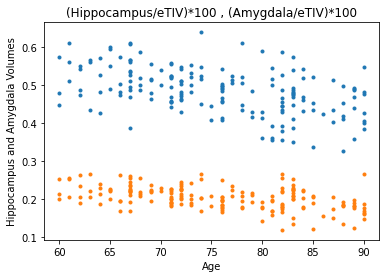

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

# A simple scatter plot with Matplotlib
ax = plt.axes()

ax.scatter(dataFrees.Age, ((dataFrees['Right.Hippocampus']+dataFrees['Left.Hippocampus'])/dataFrees['EstimatedTotalIntraCranialVol'])*100,marker='.',label='Hippocampus')
ax.scatter(dataFrees.Age, ((dataFrees['Right.Amygdala']+dataFrees['Left.Amygdala'])/dataFrees['EstimatedTotalIntraCranialVol'])*100,marker='.',label='Amygdala')

# Label the axes
ax.set(xlabel='Age',
       ylabel='Hippocampus and Amygdala Volumes',
       title=('(Hippocampus/eTIV)*100 , (Amygdala/eTIV)*100'))
### END SOLUTION


[Text(0, 0.5, 'Left Hippocampus Volume [mm3]'),
 Text(0.5, 0, 'Age'),
 Text(0.5, 1.0, '(Right Hippocampus Volume [mm3]')]

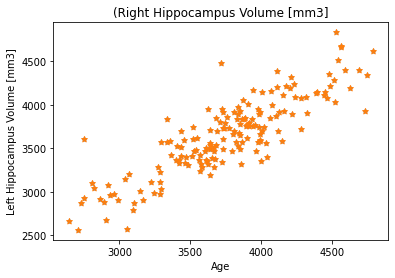

In [ ]:
# A simple scatter plot with Matplotlib
ax = plt.axes()

ax.scatter(dataFrees['Right.Hippocampus'],dataFrees['Left.Hippocampus'],marker='.',label='F')
ax.scatter(dataFrees['Right.Hippocampus'],dataFrees['Left.Hippocampus'],marker='*',label='M')
# Label the axes
ax.set(xlabel='Age',
       ylabel='Left Hippocampus Volume [mm3]',
       title=('(Right Hippocampus Volume [mm3]'))
### END SOLUTION


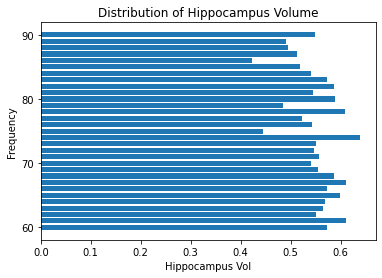

In [ ]:
fig,ax = plt.subplots()
ax.barh(dataFrees.Age,((dataFrees['Right.Hippocampus']+dataFrees['Left.Hippocampus'])/dataFrees['EstimatedTotalIntraCranialVol'])*100);
ax.set_yticks(np.arange(60,100,10))
ax.set_yticklabels(np.arange(60,100,10))
ax.set(xlabel='Hippocampus Vol',
       ylabel='Frequency',
       title='Distribution of Hippocampus Volume');

In [ ]:
dataFrees.groupby('Sex').mean().plot()

NameError: ignored

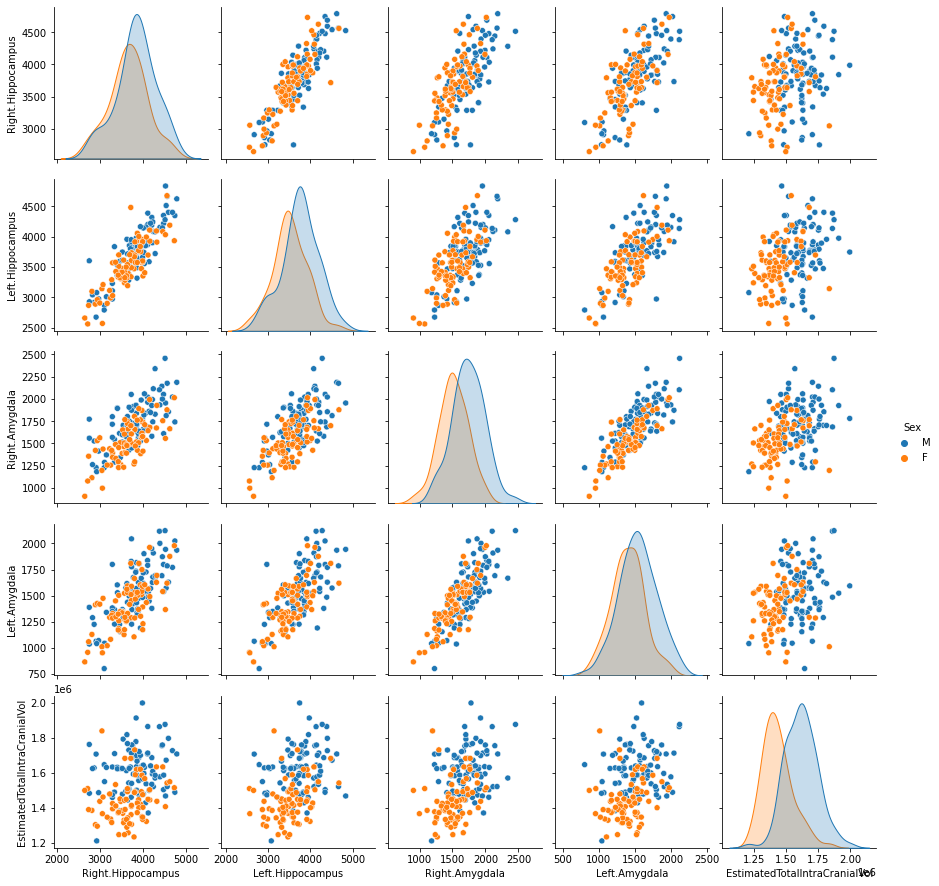

In [ ]:
sns.pairplot(dataFrees,vars=['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','EstimatedTotalIntraCranialVol'], hue='Sex')

/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))
/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))
/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tupl

<Figure size 432x288 with 0 Axes>

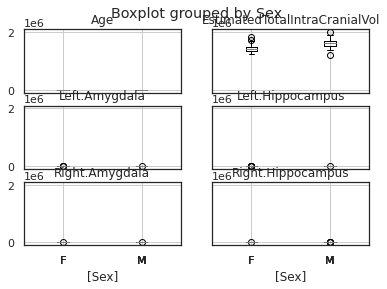

In [ ]:
sns.set_style('white')
sns.set_context('notebook')
sns.set_palette('dark')
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','EstimatedTotalIntraCranialVol','Age','Sex']]
f = plt.figure(figsize=(6,4))
data.boxplot(by='Sex');

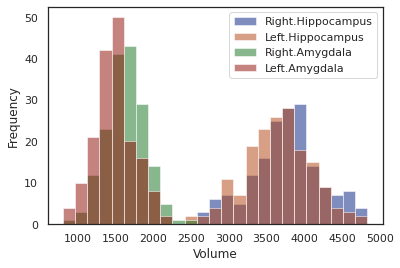

In [ ]:
sns.set_context('notebook')
### BEGIN SOLUTION
# This uses the `.plot.hist` method
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala']]
ax =data.plot.hist(bins=25, alpha=0.5)
ax.set_xlabel('Volume');

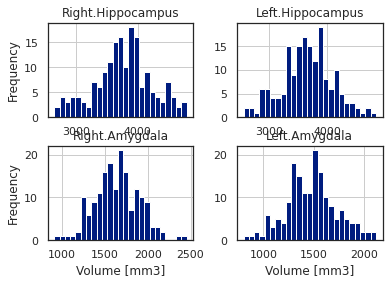

In [ ]:
# To create four separate plots, use Pandas `.hist` method
axList = data.hist(bins=25)

# Add some x- and y- labels to first column and last row
for ax in axList.flatten():
    if ax.is_last_row():
        ax.set_xlabel('Volume [mm3]')

    if ax.is_first_col():
        ax.set_ylabel('Frequency')
### END SOLUTION

/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))
/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))
/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tupl

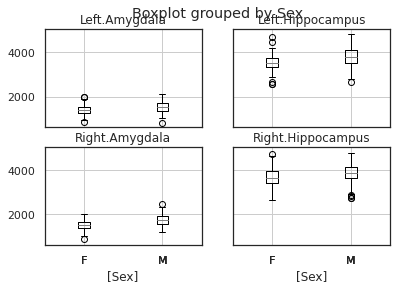

In [ ]:
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Sex']]
data.boxplot(by='Sex');

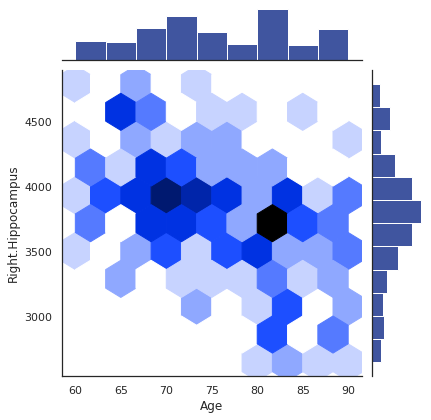

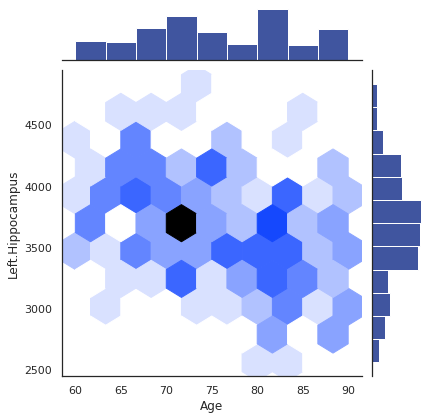

In [ ]:
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Sex','Age']]
#da una idea de las densidades de los puntos, del lugar mas común
sns.jointplot(x=data['Age'], y=data['Right.Hippocampus'],kind='hex')
sns.jointplot(x=data['Age'], y=data['Left.Hippocampus'],kind='hex')

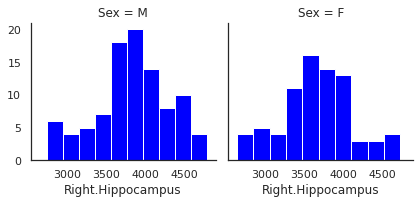

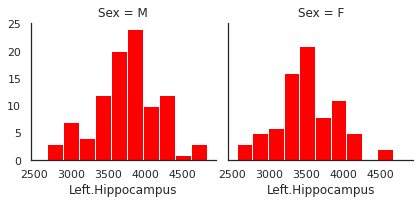

In [ ]:
plot=sns.FacetGrid(data, col='Sex',margin_titles=True)
plot.map(plt.hist,'Right.Hippocampus',color='blue')
plot=sns.FacetGrid(data, col='Sex',margin_titles=True)
plot.map(plt.hist,'Left.Hippocampus',color='red')

In [ ]:
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Sex','Age']]
data.set_index('Sex').stack().to_frame()

<ipython-input-57-328bf5cb498f>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.set_index except for the argument 'keys' will be keyword-only
  data.set_index('Sex','Age').stack().to_frame()


0
Sex                          
M   Right.Hippocampus  4596.2
    Left.Hippocampus   4401.9
    Right.Amygdala     1855.1
    Left.Amygdala      1629.3
    Age                  66.0
...                       ...
F   Right.Hippocampus  4042.8
    Left.Hippocampus   3406.2
    Right.Amygdala     1710.1
    Left.Amygdala      1604.5
    Age                  72.0

[865 rows x 1 columns]

In [ ]:
data.set_index('Sex').stack().to_frame().reset_index().rename(columns={'level_1':'BrainSeg',0:'Vol'})

,Sex,BrainSeg,Vol
0,M,Right.Hippocampus,4596.2
1,M,Left.Hippocampus,4401.9
2,M,Right.Amygdala,1855.1
3,M,Left.Amygdala,1629.3
4,M,Age,66.0
...,...,...,...
860,F,Right.Hippocampus,4042.8
861,F,Left.Hippocampus,3406.2
862,F,Right.Amygdala,1710.1
863,F,Left.Amygdala,1604.5


In [ ]:
plotData=data.set_index('Sex').stack().to_frame().reset_index().rename(columns={'level_1':'BrainSeg',0:'Vol'})

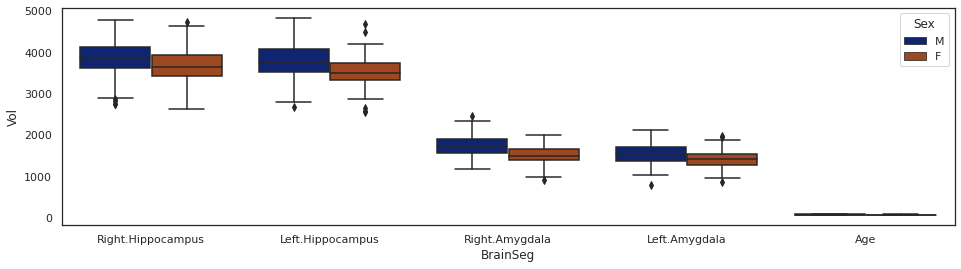

In [ ]:
sns.set_style('white')
sns.set_context('notebook')
sns.set_palette('dark')

f = plt.figure(figsize=(16,4))
sns.boxplot(x='BrainSeg', y='Vol',  hue='Sex', data=plotData);

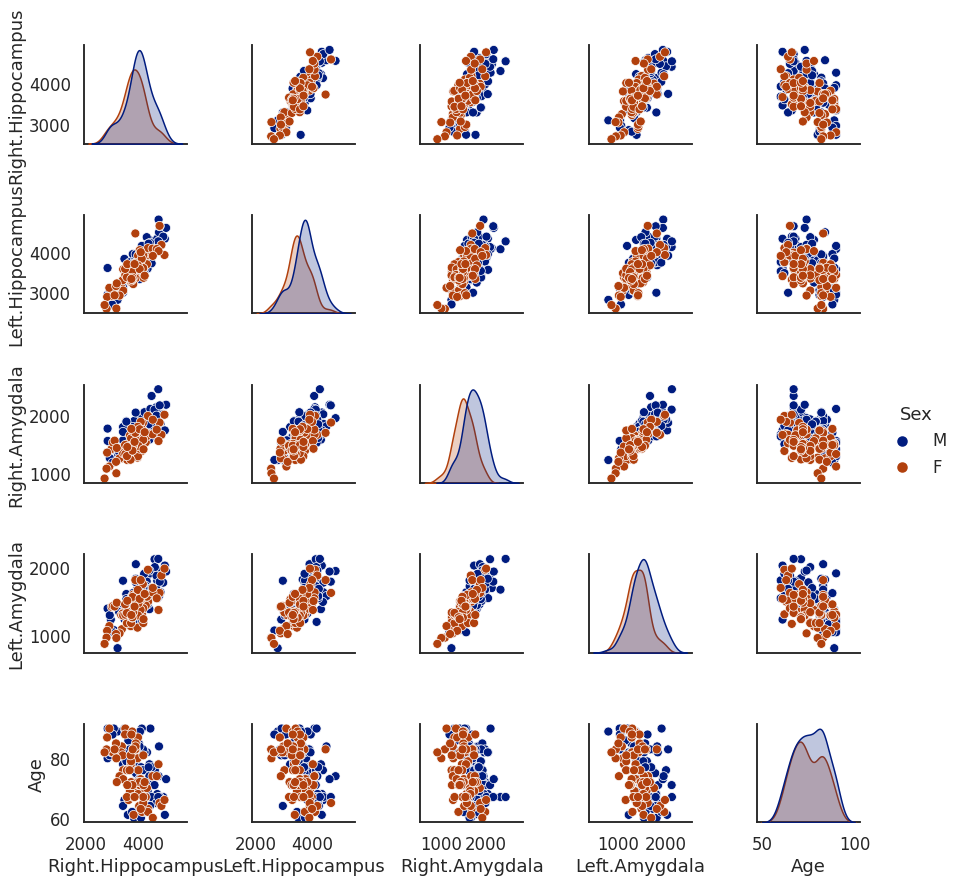

In [ ]:
sns.set_context('talk')
sns.pairplot(data, hue='Sex');

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

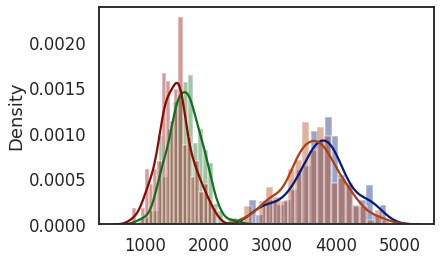

In [ ]:
sns.distplot(dataFrees[['Right.Hippocampus']],bins=20)
sns.distplot(dataFrees[['Left.Hippocampus']],bins=20)
sns.distplot(dataFrees[['Right.Amygdala']],bins=20)
sns.distplot(dataFrees[['Left.Amygdala']],bins=20)
#sns.distplot(dataFrees[['Age']],bins=20)

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

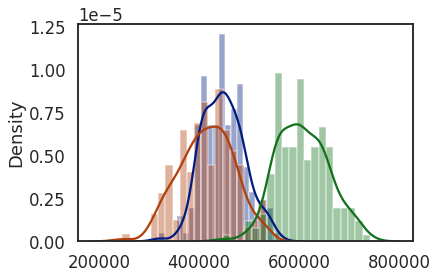

In [ ]:
#sns.distplot(dataFrees[['CSF']],bins=20)
sns.distplot(dataFrees[['CortexVol']],bins=20)
sns.distplot(dataFrees[['CerebralWhiteMatterVol']],bins=20)
sns.distplot(dataFrees[['TotalGrayVol']],bins=20)

#Trabajo con la distribución de las variables:
##Analizo skew:
Los que tienen valores mayores a 0.75 se deben transformar xq tienen mucho skew, están lejos de la distribución normal, nros negativos son skew a la izquierda, positivos skew a la derecha, cero no skew.
En caso de presentar valores mayores al límite, debo transformar las variables a log, de modo de llevar la distribución a una normal.

In [ ]:
#nro columnas q son tipo nro
num_cols=dataFrees.select_dtypes(include=[np.number]).columns
print(dataFrees.select_dtypes(include=[np.number]).columns)
skew_limit = 0.75 # define a limit above which we will log transform
skew_vals_num = dataFrees[num_cols].skew()
print('skew_vals= ',skew_vals_num)
#ahora quiero ver los skew values cuyo valor abs es mayor al límite, ordenados en forma ascendente
skew_cols_num = (skew_vals_num
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))

skew_cols_num


Index(['Left.Lateral.Ventricle', 'Left.Inf.Lat.Vent',
       'Left.Cerebellum.White.Matter', 'Left.Cerebellum.Cortex',
       'Left.Thalamus.Proper', 'Left.Caudate', 'Left.Putamen', 'Left.Pallidum',
       'X3rd.Ventricle', 'X4th.Ventricle',
       ...
       'rh_superiortemporal_thickness', 'rh_supramarginal_thickness',
       'rh_frontalpole_thickness', 'rh_temporalpole_thickness',
       'rh_transversetemporal_thickness', 'rh_insula_thickness',
       'rh_MeanThickness_thickness', 'Age', 'Asy', 'HOC'],
      dtype='object', length=183)
skew_vals=  Left.Lateral.Ventricle          1.693800
Left.Inf.Lat.Vent               3.080950
Left.Cerebellum.White.Matter   -0.062244
Left.Cerebellum.Cortex          0.064660
Left.Thalamus.Proper            0.387003
                                  ...   
rh_insula_thickness            -0.151005
rh_MeanThickness_thickness     -0.272818
Age                            -0.000069
Asy                             0.288290
HOC                            -1

,Skew
Right.Inf.Lat.Vent,3.653858
WM.hypointensities,3.568721
Left.vessel,3.157591
Left.Inf.Lat.Vent,3.080950
CSF,2.242938
Right.vessel,2.072098
Left.Lateral.Ventricle,1.693800
Right.Lateral.Ventricle,1.683244
CC_Mid_Anterior,1.585016
SurfaceHoles,1.567924


#Evaluo cómo cambia la distribución de la variable aplicando logaritmo

<ipython-input-64-941341244dac>:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))


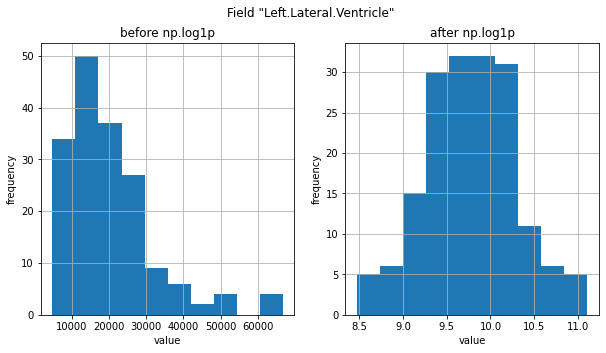

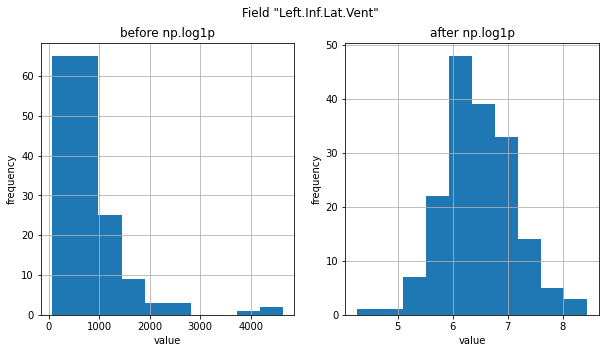

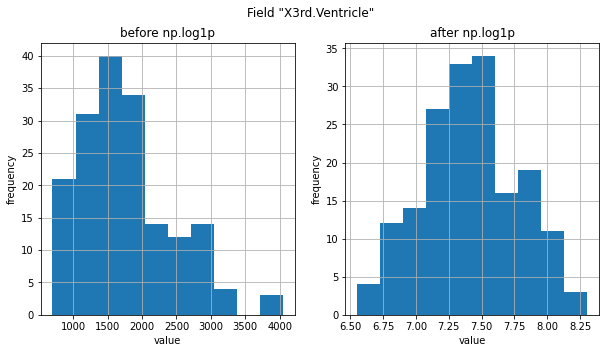

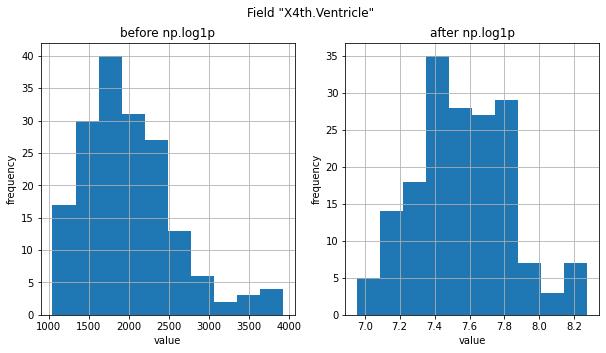

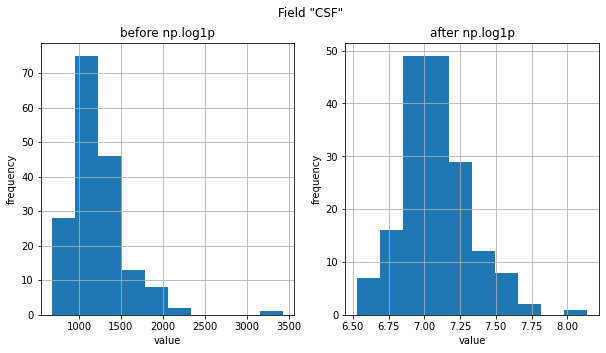

...

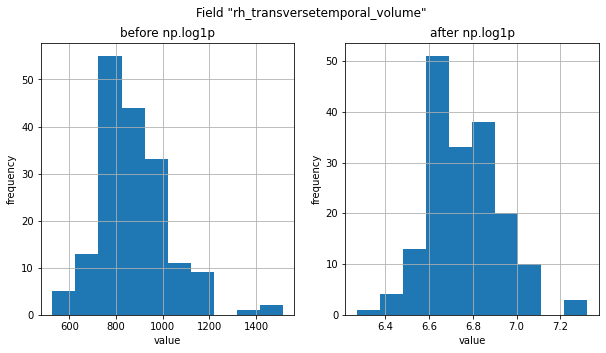

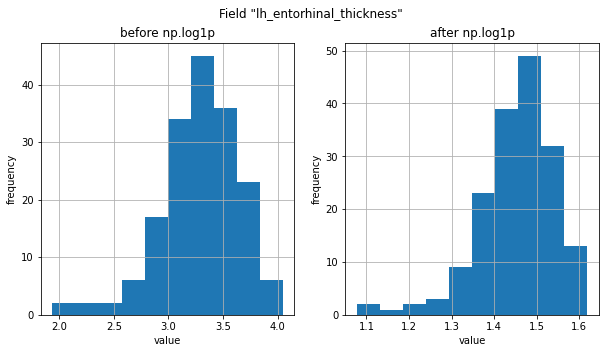

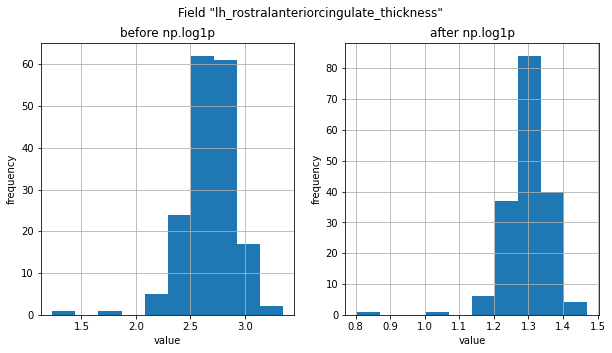

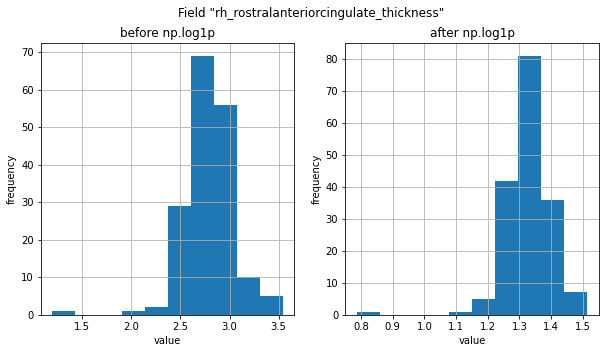

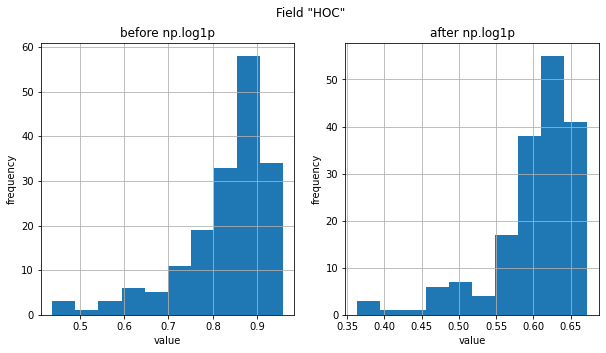

In [ ]:
# Let's look at what happens to one of these features, when we apply np.log1p visually.

e=skew_vals_num.index[abs(skew_vals_num)>=skew_limit] #elijo los volúmenes con skew mayor al límite
# Choose a field
#field = "Right.Inf.Lat.Vent" #en caso de querer ver solo un volúmen
for field in list(e): #todos los vol con skew mayor al límite
  # Create two "subplots" and a "figure" using matplotlib
  fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))

  # Create a histogram on the "ax_before" subplot
  dataFrees[field].hist(ax=ax_before)

  # Apply a log transformation (numpy syntax) to this column
  dataFrees[field].apply(np.log1p).hist(ax=ax_after)

  # Formatting of titles etc. for each subplot
  ax_before.set(title='before np.log1p', ylabel='frequency', xlabel='value')
  ax_after.set(title='after np.log1p', ylabel='frequency', xlabel='value')
  fig.suptitle('Field "{}"'.format(field));

Una vez que evaluo si vale la pena o no realizar la transformación en todas las partes con skews importantes, lo realizo con:

In [ ]:
# Perform the skew transformation:
#en caso de querer sacar alguna parte debo modificar e
#por ejemplo para sacar HOC
e=skew_vals_num.index[abs(skew_vals_num)>=skew_limit] #elijo los volúmenes con skew mayor al límite
e=e[e!='HOC'] #saco 'HOC'

print(e)
for field in list(e):
    dataFrees[field] = dataFrees[field].apply(np.log1p)

Chequeo los datos nulos o faltantes de cada variable

In [ ]:

# There are a *lot* of variables. Let's go back to our saved original data and look at how many values are missing for each variable.

dataFrees.isnull().sum().sort_values()


Measure.volume                        0
lh_inferiortemporal_thickness         0
lh_isthmuscingulate_thickness         0
lh_lateraloccipital_thickness         0
lh_lateralorbitofrontal_thickness     0
                                     ..
lh_precentral_volume                  0
lh_precuneus_volume                   0
lh_rostralanteriorcingulate_volume    0
lh_paracentral_volume                 0
HOC                                   0
Length: 186, dtype: int64

In [ ]:
#Utilizo la parte de datos que me interesa y observo sus cualidades
data=dataFrees[['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Sex','Age']]
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Right.Hippocampus,173.0,3757.100000,464.151165,2642.5,3482.2,3775.7,4010.3,4791.2
Left.Hippocampus,173.0,3649.878613,438.157949,2562.2,3371.4,3660.9,3917.8,4834.7
Right.Amygdala,173.0,1637.818497,260.783443,907.3,1474.9,1639.3,1811.8,2454.5
Left.Amygdala,173.0,1478.372832,255.603674,802.0,1313.1,1485.5,1619.7,2122.3
Age,173.0,75.647399,8.313442,60.0,69.0,76.0,83.0,90.0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 173 entries, 0 to 172
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Right.Hippocampus  173 non-null    float64
 1   Left.Hippocampus   173 non-null    float64
 2   Right.Amygdala     173 non-null    float64
 3   Left.Amygdala      173 non-null    float64
 4   Sex                173 non-null    object 
 5   Age                173 non-null    int64  
dtypes: float64(4), int64(1), object(1)
memory usage: 8.2+ KB


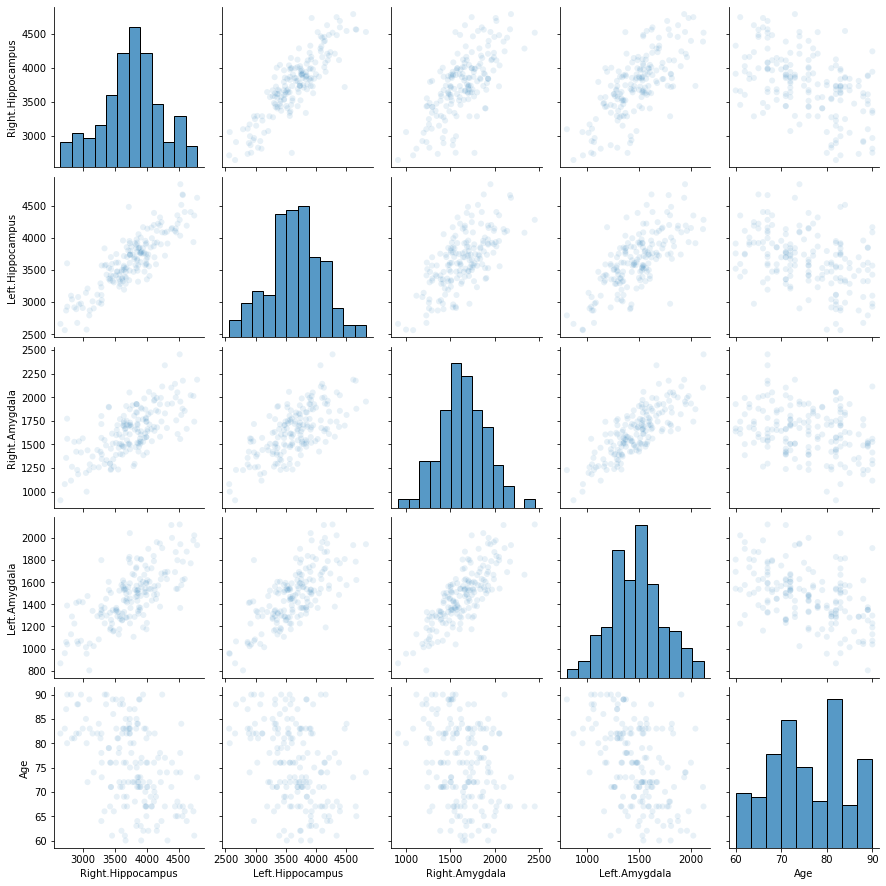

In [ ]:
sns.pairplot(data, plot_kws=dict(alpha=.1, edgecolor='none'))

Comienzo el procesamiento de Machine learning, veo si puedo estimar la edad

In [ ]:
X=data.loc[:,['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Sex']]
y=data['Age']
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 173 entries, 0 to 172
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Right.Hippocampus  173 non-null    float64
 1   Left.Hippocampus   173 non-null    float64
 2   Right.Amygdala     173 non-null    float64
 3   Left.Amygdala      173 non-null    float64
 4   Sex                173 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.9+ KB


In [ ]:
#para ver si hay cantidad de datos similares para cada categoría
data['Sex'].value_counts()

M    96
F    77
Name: Sex, dtype: int64

In [ ]:
#si los quisiera pasar a variables, donde serán cero o uno para M y F
pd.get_dummies(data['Sex'], drop_first=True).head()
#Si quisiera agrupar varias categorías xq tienen muy pocos valores respecto al resto, lo hago con :
# other_nbhs = list(nbh_counts[nbh_counts <= 8].index)  #lista las categorias q tienen menos de 8 datos
#X1 = data.copy()  #copio los datos como venían hasta ahora
# y reemplazo las categorias escasas por una nueva categoría en común
#X1['Neighborhood'] = df['Neighborhood'].replace(other_nbhs, 'Other')


,M
0,1
1,1
2,1
3,1
4,1


In [ ]:
#we'll calculate deviance of a row's feature value from the mean value of the category that row belongs to.
#This helps to capture information about a feature relative to the category's distribution, e.g. how nice a house is relative to other houses in its neighborhood or of its style.

#Below we define reusable code for generating features of this form, feel free to repurpose it for future feature engineering work!
def add_deviation_feature(X, feature, category):

    # temp groupby object
    category_gb = X.groupby(category)[feature]

    # create category means and standard deviations for each observation
    category_mean = category_gb.transform(lambda x: x.mean())
    category_std = category_gb.transform(lambda x: x.std())

    # compute stds from category mean for each feature value,
    # add to X as new feature
    deviation_feature = (X[feature] - category_mean) / category_std
    X[feature + '_Dev_' + category] = deviation_feature


In [ ]:
X=data.loc[:,['Right.Hippocampus','Left.Hippocampus','Right.Amygdala','Left.Amygdala','Age','Sex']]
y=data['Sex']
#add_deviation_feature(X, 'Right.Hippocampus', 'Sex') #Como el Right.Hippocampus se ve respecto a otros Right.Hippocampus, según el sexo
add_deviation_feature(X, 'Right.Hippocampus','Age') #Como el Right.Hippocampus se ve respecto a otros Right.Hippocampus, según la edad
X

,Right.Hippocampus,Left.Hippocampus,Right.Amygdala,Left.Amygdala,Age,Sex,Right.Hippocampus_Dev_Age
0,4596.2,4401.9,1855.1,1629.3,66,M,0.766331
1,3988.3,3746.8,1780.4,1593.8,67,M,-0.305346
2,3849.2,3781.6,1664.6,1473.4,71,M,0.026872
3,3757.6,3863.8,1687.6,1420.7,78,M,-0.220462
4,4443.6,4107.7,2141.8,1691.2,67,M,0.881333
...,...,...,...,...,...,...,...
168,3435.8,3699.9,1453.8,1503.1,71,F,-1.439633
169,4001.5,3352.7,1413.4,1231.3,71,F,0.567144
170,3578.5,3324.6,1767.4,1293.1,88,F,0.862095
171,3690.7,3702.6,1542.9,1416.6,67,F,-1.081001


In [ ]:
X.groupby('Age')['Right.Hippocampus'].mean()
X.groupby('Sex')['Right.Hippocampus'].mean()

Sex
F    3659.158442
M    3835.657292
Name: Right.Hippocampus, dtype: float64

In [ ]:
X.groupby('Sex')['Right.Hippocampus'].transform(lambda x:x.mean())

0      3835.657292
1      3835.657292
2      3835.657292
3      3835.657292
4      3835.657292
          ...     
168    3659.158442
169    3659.158442
170    3659.158442
171    3659.158442
172    3659.158442
Name: Right.Hippocampus, Length: 173, dtype: float64

In [ ]:
X.groupby('Sex')['Right.Hippocampus'].transform(lambda x:x.std())

0      463.760481
1      463.760481
2      463.760481
3      463.760481
4      463.760481
          ...    
168    448.564504
169    448.564504
170    448.564504
171    448.564504
172    448.564504
Name: Right.Hippocampus, Length: 173, dtype: float64

In [ ]:
X.groupby('Age')['Right.Hippocampus'].transform(lambda x:x.mean())

0      4036.925000
1      4105.453846
2      3841.625000
3      3867.520000
4      4105.453846
          ...     
168    3841.625000
169    3841.625000
170    3278.740000
171    4105.453846
172    3772.000000
Name: Right.Hippocampus, Length: 173, dtype: float64

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
#Instantiate and provide desired degree;
#   Note: degree=2 also includes intercept, degree 1 terms, and cross-terms

pf = PolynomialFeatures(degree=2)

In [ ]:
features = ['Right.Hippocampus', 'Age']
pf.fit(data[features])

PolynomialFeatures()

In [ ]:
pf.get_feature_names()  #Must add input_features = features for appropriate names

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['1', 'x0', 'x1', 'x0^2', 'x0 x1', 'x1^2']

In [ ]:
feat_array = pf.transform(data[features])
pd.DataFrame(feat_array, columns = pf.get_feature_names(input_features=features))

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,1,Right.Hippocampus,Age,Right.Hippocampus^2,Right.Hippocampus Age,Age^2
0,1.0,4596.2,66.0,21125054.44,303349.2,4356.0
1,1.0,3988.3,67.0,15906536.89,267216.1,4489.0
2,1.0,3849.2,71.0,14816340.64,273293.2,5041.0
3,1.0,3757.6,78.0,14119557.76,293092.8,6084.0
4,1.0,4443.6,67.0,19745580.96,297721.2,4489.0
...,...,...,...,...,...,...
168,1.0,3435.8,71.0,11804721.64,243941.8,5041.0
169,1.0,4001.5,71.0,16012002.25,284106.5,5041.0
170,1.0,3578.5,88.0,12805662.25,314908.0,7744.0
171,1.0,3690.7,67.0,13621266.49,247276.9,4489.0


In [ ]:
#!pip install nibabel
#!pip install SimpleITK
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
test_load = nib.load('/content/drive/MyDrive/Colab Notebooks/subjects/ADNI_33/ADNI_33.nii').get_fdata()
test_load.shape
test_load=test_load.reshape(196, 256, 256)
test_load.shape

(196, 256, 256)

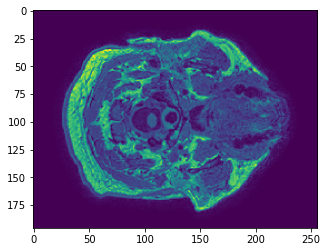

In [ ]:
test = test_load[:,:,59]
plt.imshow(test)
plt.show()

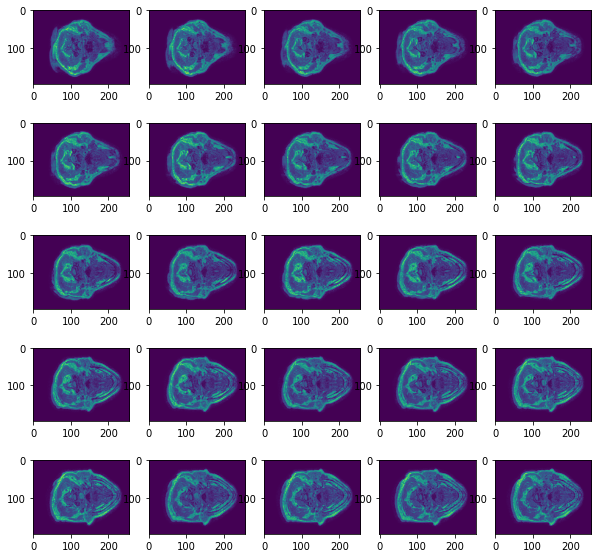

In [ ]:
for i in range(25):
    plt.subplot(5, 5,i + 1)
    plt.imshow(test_load[:,:,9 + i])
    plt.gcf().set_size_inches(10, 10)
plt.show()

In [ ]:
#!pip install nilearn
from nilearn import plotting
import pylab as plt
%matplotlib inline

import numpy as np

In [ ]:
#to compute the mean image, you  need to load the img, get the data and then compute the mean thereof
from nilearn import image as nli
t1 = nli.load_img('/content/drive/MyDrive/Colab Notebooks/subjects/ADNI_33/ADNI_33.nii')
img = nli.mean_img(t1)

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



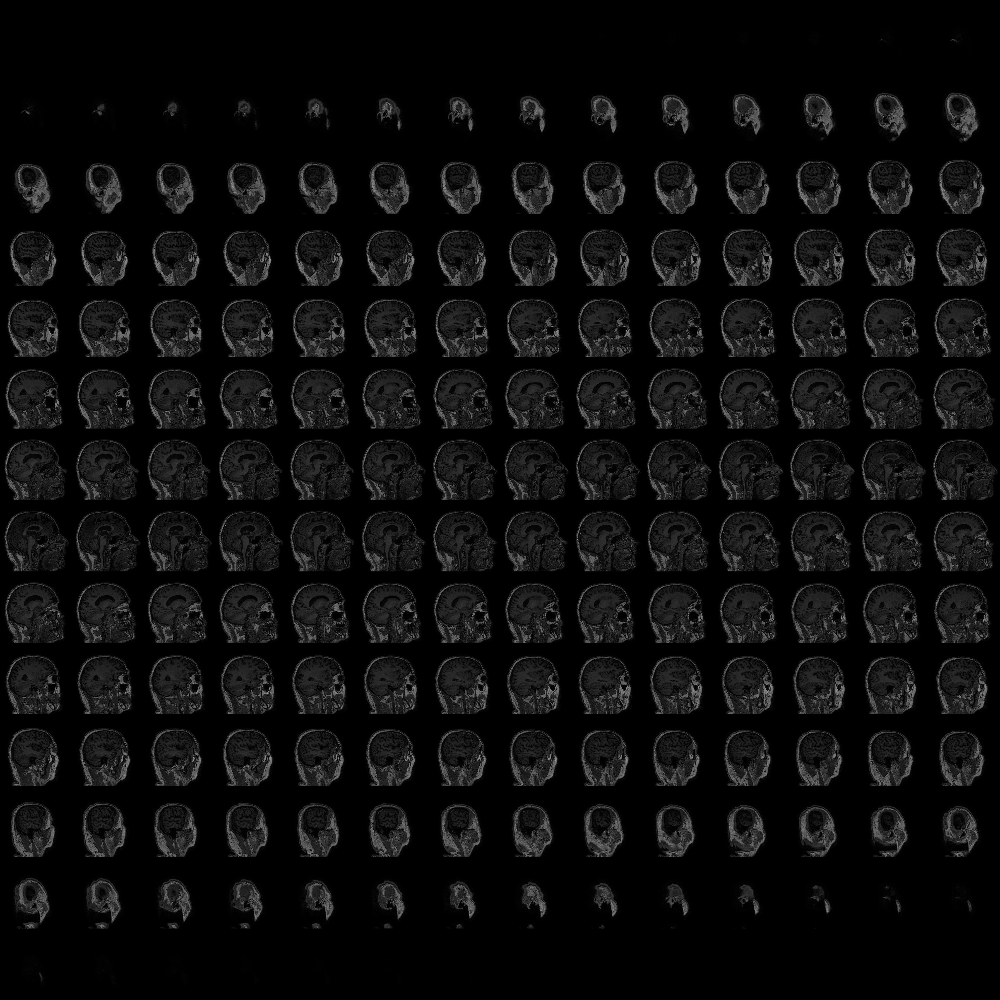
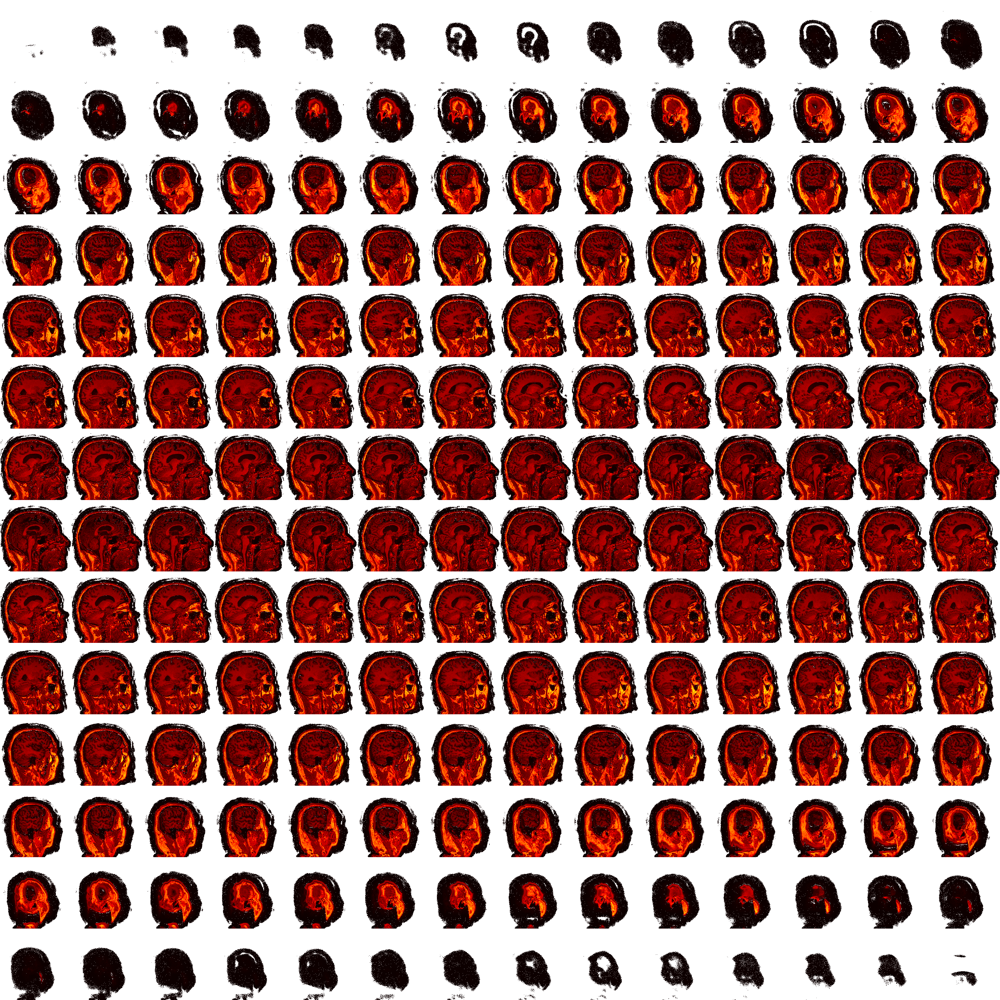

In [ ]:
plotting.view_img(img, bg_img=img)

Resample image to a template

In [ ]:
mean = nli.mean_img(t1)
print([mean.shape, t1.shape])

[(196, 256, 256), (196, 256, 256, 1)]


In [ ]:
resampled_t1 = nli.resample_to_img(t1, mean)
resampled_t1.shape

/usr/local/lib/python3.8/dist-packages/nilearn/image/resampling.py:453: UserWarning: The provided image has no sform in its header. Please check the provided file. Results may not be as expected.
  warnings.warn("The provided image has no sform in its header. "


(196, 256, 256, 1)

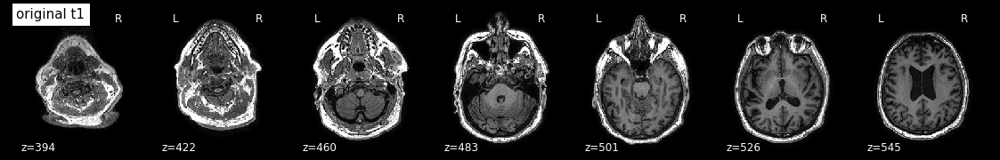

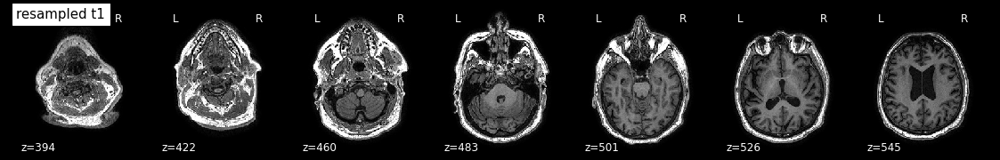

In [ ]:
from nilearn import plotting
plotting.plot_anat(t1, title='original t1', display_mode='z', dim=-1)#,cut_coords=[-20, -10, 0, 10, 20, 30])
plotting.plot_anat(resampled_t1, title='resampled t1', display_mode='z', dim=-1)#,cut_coords=[-20, -10, 0, 10, 20, 30])

#Smooth an image

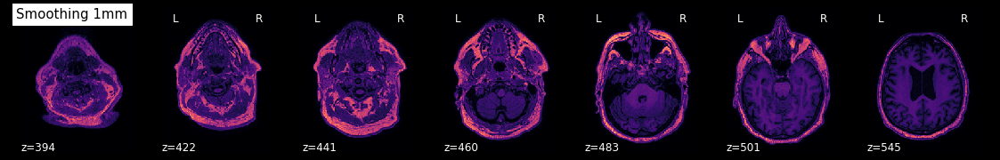

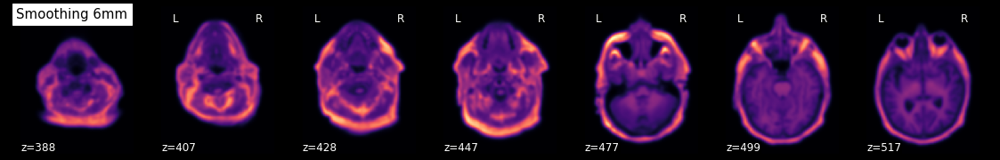

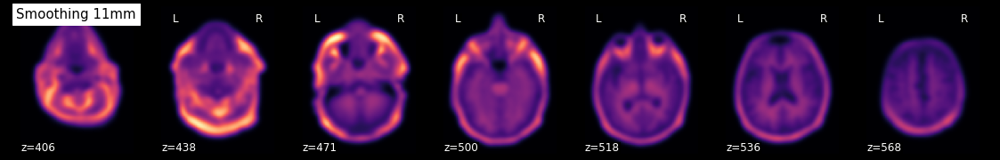

In [ ]:
for fwhm in range(1, 12, 5):
    smoothed_img = nli.smooth_img(mean, fwhm)
    plotting.plot_epi(smoothed_img, title="Smoothing %imm" % fwhm,
                     display_mode='z', cmap='magma')

#Clean an image to improve SNR (para fmri)

In [ ]:
TR = t1.header['pixdim'][3]
TR
# detrend the image.
t1_d = nli.clean_img(t1, detrend=True, standardize=False, t_r=TR)
# Plot the original and detrended timecourse of a random voxel
x, y, z = [51, 64, 57]
plt.figure(figsize=(12, 4))
plt.plot(np.transpose(t1.get_fdata()[x, y, z,1]))
plt.plot(np.transpose(t1_d.get_fdata()[x, y, z,1]))
plt.legend(['Original', 'Detrend']);
t1_ds = nli.clean_img(t1, detrend=True, standardize=True, t_r=TR)

plt.figure(figsize=(12, 4))
plt.plot(np.transpose(t1_d.get_fdata()[x, y, z, :]))
plt.plot(np.transpose(t1_ds.get_fdata()[x, y, z, :]))
plt.legend(['Detrend', 'Detrend+standardize']);

1.0

In [ ]:
import nibabel                      as nib
import nibabel.freesurfer.mghformat as mgh

# MGH/MGZ files
mgh_file = mgh.load('/content/drive/MyDrive/Colab Notebooks/subjects/ADNI_33/mri/aparc+aseg.mgz')
mgh_file.get_fdata().shape
#=> (256, 256, 256)
type(mgh_file.get_fdata())
#=> numpy.ndarray

# NifTI files
nii_file = nib.load('/content/drive/MyDrive/Colab Notebooks/subjects/ADNI_33/ADNI_33.nii')
nii_file.get_fdata().shape
#=> (256, 256, 256)
type(nii_file.get_fdata())
#=> numpy.ndarray

numpy.memmap

In [ ]:
!pip install neuropythy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 19.6 MB 89.8 MB/s 
     |████████████████████████████████| 269 kB 61.1 MB/s 
     |████████████████████████████████| 60 kB 6.2 MB/s 
     |████████████████████████████████| 200 kB 39.8 MB/s 
     |████████████████████████████████| 66 kB 4.6 MB/s 
     |████████████████████████████████| 9.1 MB 53.7 MB/s 
     |████████████████████████████████| 140 kB 49.2 MB/s 
  Created wheel for neuropythy: filename=neuropythy-0.12.7-py3-none-any.whl size=19620498 sha256=cf4ed71bc37c66cce921de60e3331df1092577eb31b603cfcfc36a60e5d7bf8e
  Stored in directory: /root/.cache/pip/wheels/56/05/44/1fea47548383e1eaf385c580170d8536a2fe752ddb6e425165
  Created wheel for pimms: filename=pimms-0.3.20-py3-none-any.whl size=60227 sha256=fc349dc87a58c57689ac4835ac335d9c72a25db8e030b528daa7efd1d280cc97
  Stored in directory: /root/.cache/pip/wheels/90/57/b3/957491fb12eb3f76001183aa

In [ ]:
import matplotlib.pyplot as plt
import neuropythy as ny

sub = ny.freesurfer_subject('bert')
vol = sub.lh_gray_mask

(f, (ax_xy, ax_yz, ax_xz)) = plt.subplots(1,3, figsize=(12,4))

ax_xy.imshow(vol[:,:,100].T,  cmap='gray', origin='lower')
ax_xy.set_xlabel('Index $i$ (R $\mapsto$ L)')
ax_xy.set_ylabel('Index $j$ (S $\mapsto$ I)')

ax_yz.imshow(vol[160,:,:].T, cmap='gray', origin='lower')
ax_yz.set_xlabel('Index $j$ (S $\mapsto$ I)')
ax_yz.set_ylabel('Index $k$ (P $\mapsto$ A)')

ax_xz.imshow(vol[:,100,:],   cmap='gray', origin='lower')
ax_xz.set_xlabel('Index $k$ (P $\mapsto$ A)')
ax_xz.set_ylabel('Index $i$ (R $\mapsto$ L)')

plt.tight_layout()

ValueError: ignored